# Determinación del número de semillas de una ornamental (Viola spp.), color y variables de forma.

## Sección 1. Importación de librerías e imagen

In [2]:
# Set the notebook display method
# inline = embedded plots, notebook = interactive plots
#para que se presenten las imagenes incertadas en cada uno de las celdas de resultado usando matplotlib
%matplotlib inline

In [3]:
#Importanción de librerías
#os-- para el manejo de archivos, llamar, guardar
#argparse-- es para automatizar comandos
#cv2 para el analisis de imagenes y video
#numpy analisis matematico en phyton


%matplotlib notebook
import os
import argparse
import matplotlib
import cv2
import numpy as np

from plantcv import plantcv as pcv

#Librería para contar número de objetos (Cálculo del número de Euler)
import mahotas



### Variables de entrada

In [4]:
# Input image into self.image (include file path if image is not in 
# the same folder as jupyter notebook)

# Set self.debug to "plot" so that image outputs for each step is shown
# once cell is run in jupyter notebooks (recommended)
#llamar al archivo que se llama semillas.jpg

class options:
    def __init__(self):        
        self.image = "./imagenes/semillas.jpg"
        self.debug = "plot"
        self.writeimg = False
        self.result = "seed_analysis_results.cvs"
        self.outdir = "."

In [5]:
# Get options
args = options()

# Set debug to the global parameter
pcv.params.debug = args.debug

# Set plotting size (default = 100) --- definir cuantos puntos por pulgada
pcv.params.dpi = 100

# Increase text size and thickness to make labels clearer --- tamaño del texto para hacer las etiquetas mas claras
# (size may need to be altered based on original image size)
pcv.params.text_size = 10
pcv.params.text_thickness = 20

## Lectura de la imagen de entrada

<IPython.core.display.Javascript object>


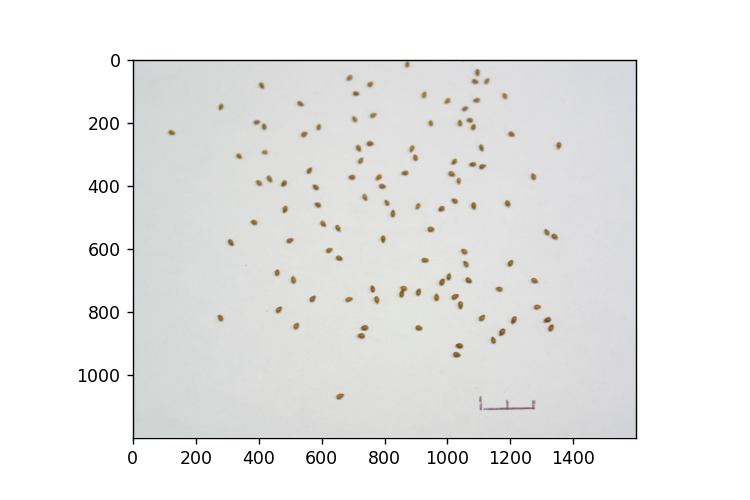

In [6]:
# Inputs:
#   filename = Image file to be read in 
#   mode     = How to read in the image; either 'native' (default), 'rgb', 'gray', or 'csv'
img, path, filename = pcv.readimage(filename=args.image)

## Sección 2. Segmentación e identificación de objetos

### Corte y selección del área de interés

<IPython.core.display.Javascript object>


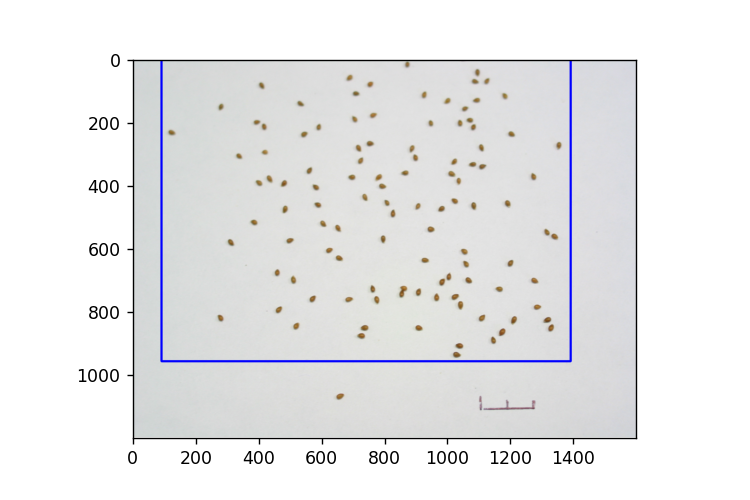

In [7]:
# Inputs:
#   x = top left x-coordinate
#   y = top left y-coordinate
#   h = height of final cropped image
#   w = width of final cropped image
img1 = pcv.crop(img=img, x=90, y=0, h=960, w=1300)

### Visualización de los diversos espacios de color

<IPython.core.display.Javascript object>


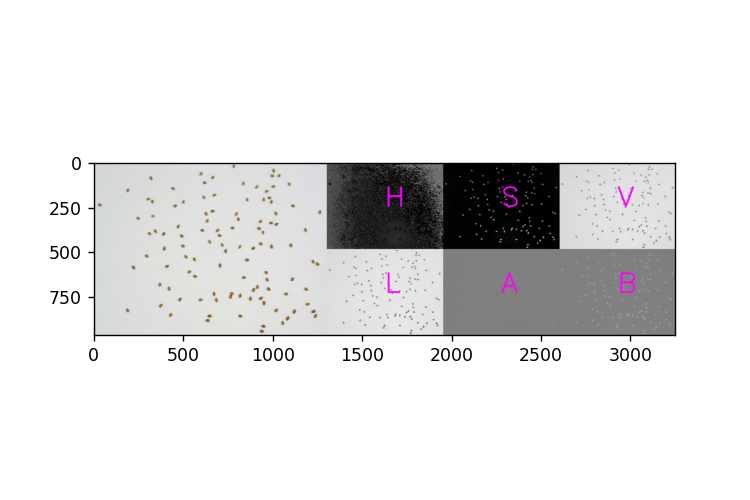

In [8]:
# Inputs:
#   rbg_img      = original image
#   original_img = whether to include the original RGB images in the display: True (default) or False
colorspace_img = pcv.visualize.colorspaces(rgb_img=img1)

### Conversión de la imagen a escala de grises

<IPython.core.display.Javascript object>


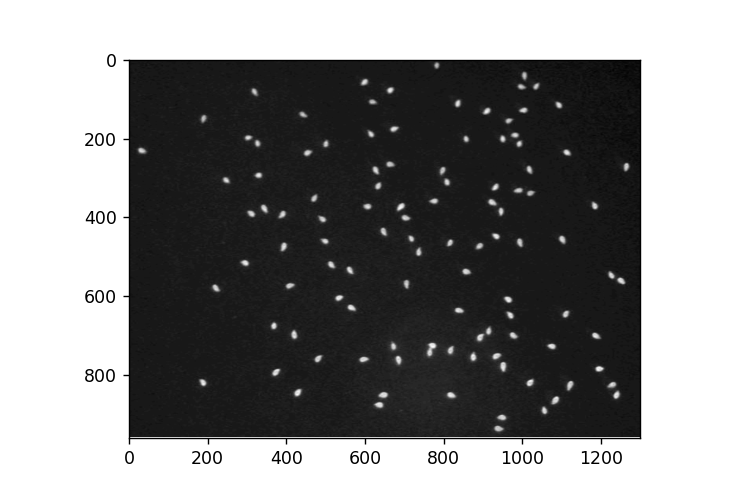

In [9]:
# Inputs:
#   rbg_img - original image
#   channel - desired colorspace ('l', 'a', or 'b')
b_img = pcv.rgb2gray_lab(rgb_img=img1, channel='b')

### Se visualiza la distribución de los valores en escala de grises en una gráfica

<IPython.core.display.Javascript object>


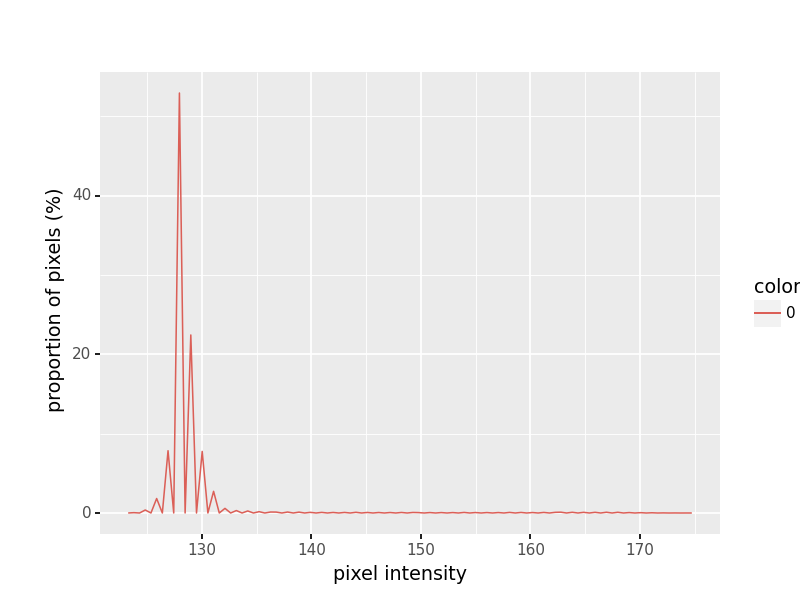

In [10]:
# Inputs:
#   img         = gray image in selected colorspace
#   mask        = None (default), or mask
#   bins        = 100 (default) or number of desired number of evenly spaced bins
#   lower-bound = None (default) or minimum value on x-axis
#   upper-bound = None (default) or maximum value on x-axis
#   title       = None (default) or custom plot title
#   hist_data   = False (default) or True (if frequency distribution data is desired)
hist = pcv.visualize.histogram(b_img)

<IPython.core.display.Javascript object>


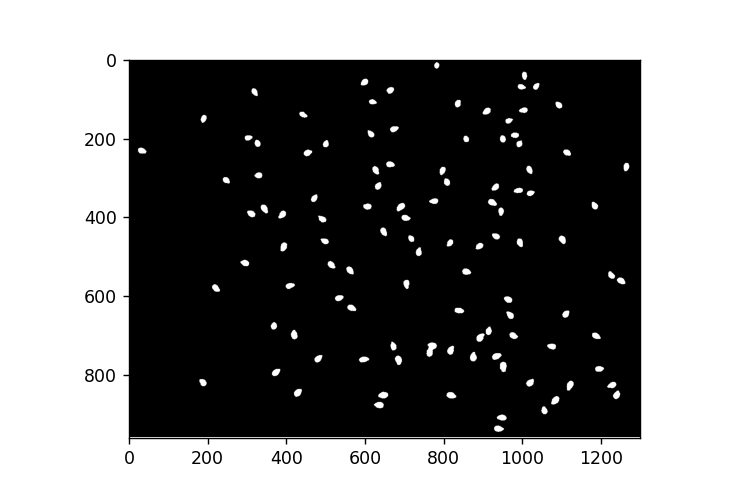

In [11]:
### Se definen umbrales

# Inputs:
#   gray_img    = black and white image created from selected colorspace
#   threshold   = cutoff pixel intensity value (all pixels below value will become black, all above will become white)
#   max_value   = maximum pixel value
#   object_type = 'dark' or 'light' depending on if seeds are darker or lighter than background
b_thresh = pcv.threshold.binary(gray_img=b_img, threshold=139, max_value=150, object_type='light')


## Eliminación de ruido del fondo, es decir eliminación de objetos de tamaño pequeño

La aplicación de un umbral asigna a los píxeles de la semilla un color blanco pero también hay pequeñas imperfecciones en los píxeles del fondo que se les asigna este color. La función "fill" elimina ruido del fondo llamado "sal" mediante un filtrado del fondo de acuerdo al tamaño de los objetos.

<IPython.core.display.Javascript object>


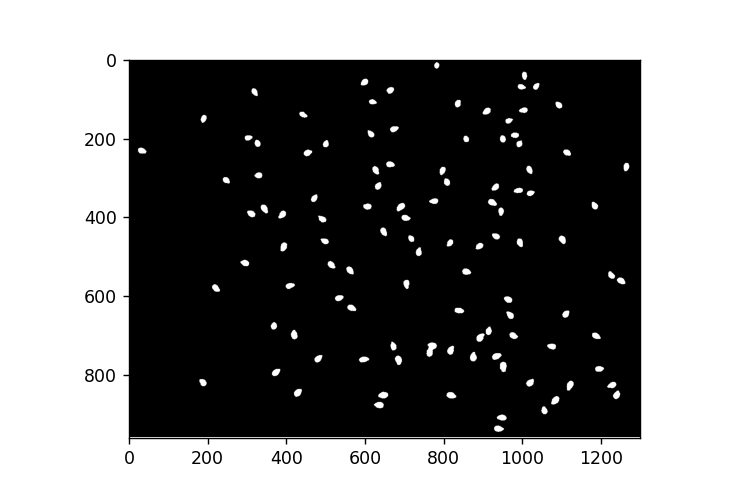

In [12]:
# Inputs:
#   bin_img - binary mask image
#   size - maximum size for objects that should be filled in as background (non-plant) pixels
b_fill = pcv.fill(bin_img=b_thresh, size=100)
#                                         ^
#                                         |
#                                 change this value


## Sección 3. Conteo y análisis de semillas

Para esto se necesita una máscara binaria completa


### Identificación simple de objetos

La máscara binaria se usa para encontrar objetos o contornos de cada una de las semillas. A diferencia de la función find_objects, esta aplicación usa la función findContours del programa OpenCV con la entrada cv2.RETR_EXTERNAL que ignora contornos en capas. La salida de este paso se puede usar para contar semillas, pero no se puede usar como entrada para análisis de color o forma.

In [13]:
# Inputs:
#   mask = binary mask with extra noise filled in
#b_fill nombre del archivo, lo de mas se deja lo mismo
objects = cv2.findContours(b_fill, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
#print(objects) # arroja una matriz con dos valores diferentes 
print(objects[0])
#print(objects[0][0][0])
#print(objects[1][0])

(array([[[933, 931]],

       [[932, 932]],

       [[931, 932]],

       [[930, 932]],

       [[929, 933]],

       [[928, 934]],

       [[928, 935]],

       [[927, 936]],

       [[927, 937]],

       [[927, 938]],

       [[927, 939]],

       [[927, 940]],

       [[928, 941]],

       [[928, 942]],

       [[929, 943]],

       [[930, 944]],

       [[931, 944]],

       [[932, 945]],

       [[933, 945]],

       [[934, 945]],

       [[935, 945]],

       [[936, 946]],

       [[937, 946]],

       [[938, 946]],

       [[939, 946]],

       [[940, 945]],

       [[941, 945]],

       [[942, 945]],

       [[943, 945]],

       [[944, 945]],

       [[945, 944]],

       [[946, 944]],

       [[947, 943]],

       [[948, 942]],

       [[949, 942]],

       [[950, 941]],

       [[951, 940]],

       [[951, 939]],

       [[951, 938]],

       [[950, 937]],

       [[949, 937]],

       [[948, 936]],

       [[947, 936]],

       [[946, 935]],

       [[945, 934]],

       [[

### Conteo de semillas

Cuenta el número de semillas (objetos simples) mediante el acceso al número de valores almacenados en el segundo item de la lista de objetos.

In [14]:
# Find number of seeds

# Inputs:
#    contours = list of contours
#funcion lend nos da el contenido del objeto
# con 0 da el fond0
# con 1 nos cuenta el numero de objetos (semillas)
# son 0 o 1 ya que es un duplex
number_seeds = len(objects[0])
print(len(objects[0]))

107


In [15]:
#Se convierte los datos de la imagen en boolean (blanco =True, negro = False)
#se hace la matriz b_fill es la binaria

arraybool=np.array(b_fill, dtype=bool)


#El número de Euler (número entero) calcula el número de objetos menos el número de
#agujeros en los objetos.
#Se usa la función euler de la librería mahotas

#parámetros:
    #-imagen binaria de dos dimensiones
    #- Entero, conectividad. Opciones: 4 u 8. Default: 8
    #-mode: {‘reflect’, ‘nearest’, ‘wrap’, ‘mirror’, ‘constant’ [default]} --- no es necesario
    
nsemillas=mahotas.euler(arraybool,8)
print('Número de semillas:', nsemillas)

#en el propio programa hay forma de guardar las variables, por lo que se genera una nueva con plantcv

# Create a new measurement
pcv.outputs.add_observation(sample='default', variable='nsemillas', 
                            trait='Number of seeds',
                            method='cuenta de semillas', scale='number', datatype=int,
                            value=nsemillas, label='number_of_seeds')

Número de semillas: 107.0


### Identificación de semillas para el análisis de forma y color

Para el análisis de color y forma, se requiere usar la función find_objects del programa PlantCV para obtener los objetos y la jerarquía de los objetos que necesitamos como entradas en los siguientes análisis.

Las funciones findContours de OpenCV y find_objects de PlantCV no se comportan de la misma manera ni tampoco proveen el mismo tipo de salidas, y por eso se deben identificar los objetos dos veces en este programa.

<IPython.core.display.Javascript object>


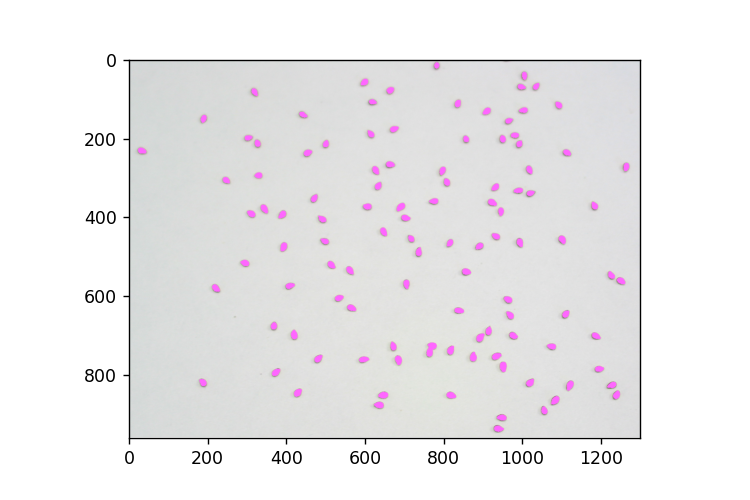

In [16]:
# Inputs:
#   img  = rgb image
#   mask = binary mask
#funcion de plant cv
objects2, obj_hierarchy = pcv.find_objects(img=img1, mask=b_fill)

### Mediciones en cada semilla

Para hacer mediciones en cada semilla, se tienen que hacer iteraciones en cada objeto (lo cual sucede cuando obj_hierarchy[0][i][3] == -1. Para cada objeto, se siguen los siguientes pasos:
1. Se consolidan los contornos, de tal forma que todos los contornos que corresponden a una semilla se compilan en un objeto simple y con una máscara.
2. Se analiza la forma de la semilla.
3. Se analiza el color de la semilla


<IPython.core.display.Javascript object>


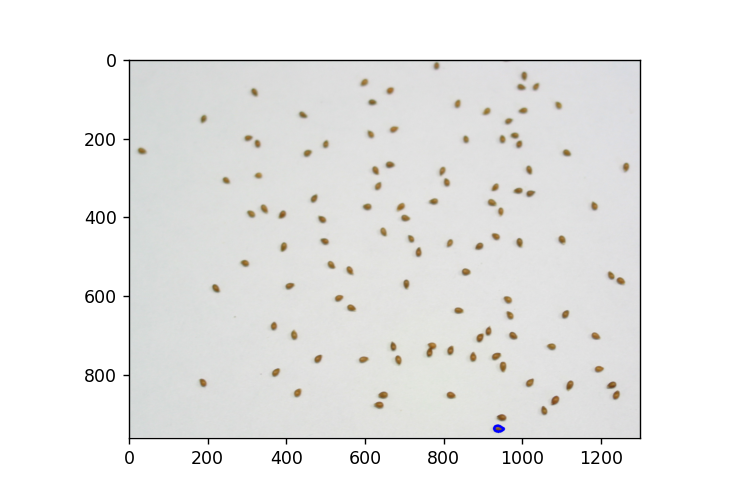

<IPython.core.display.Javascript object>


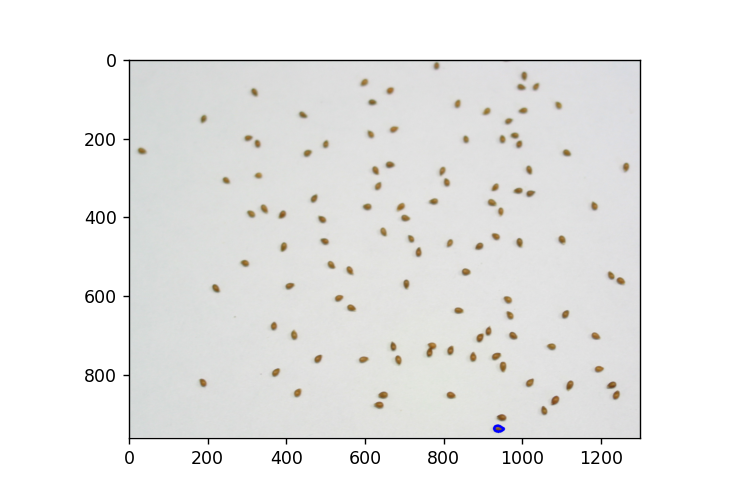

<IPython.core.display.Javascript object>


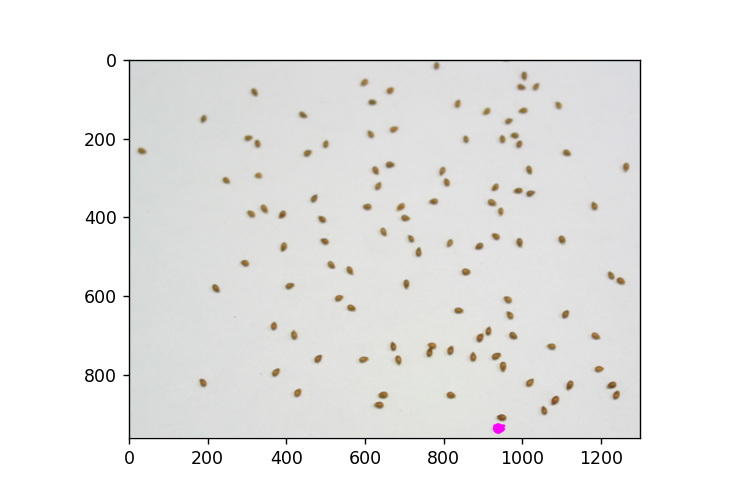

<IPython.core.display.Javascript object>


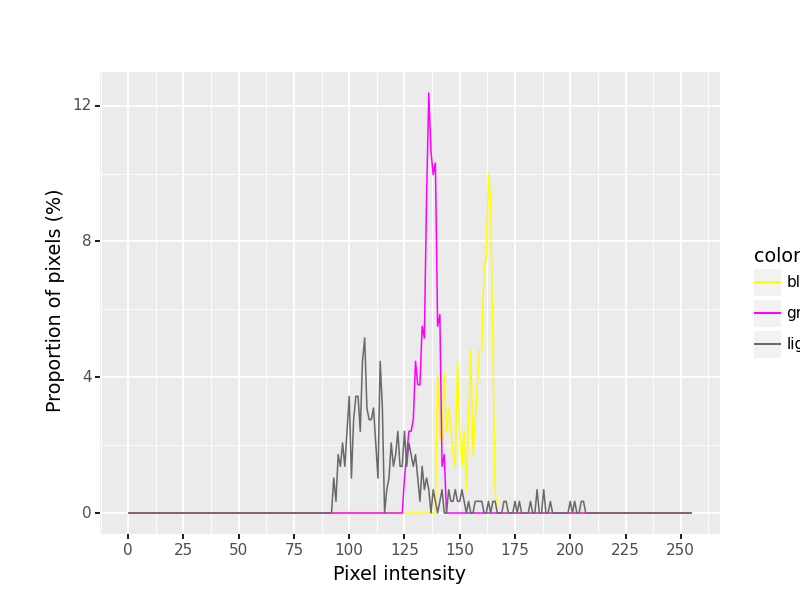

<IPython.core.display.Javascript object>


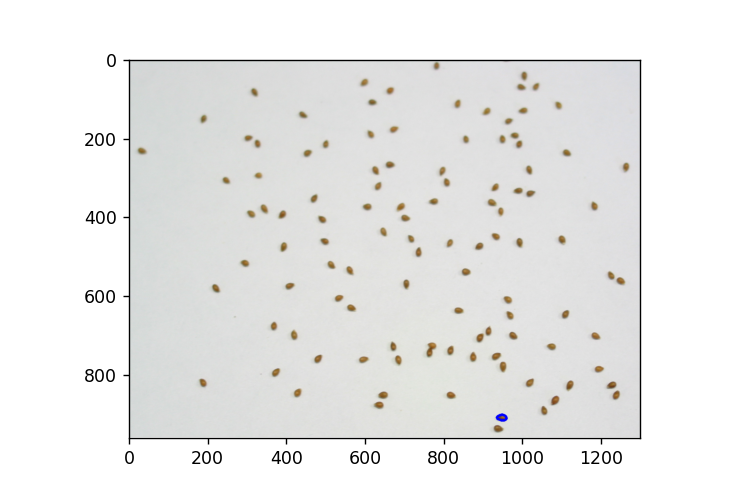

<IPython.core.display.Javascript object>


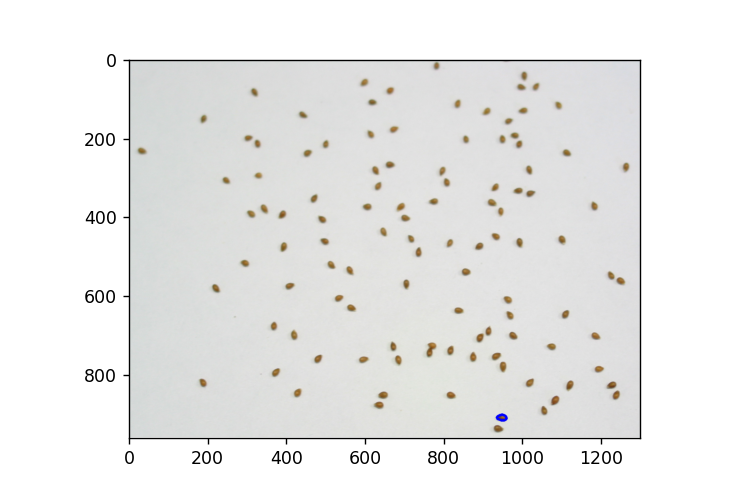

<IPython.core.display.Javascript object>


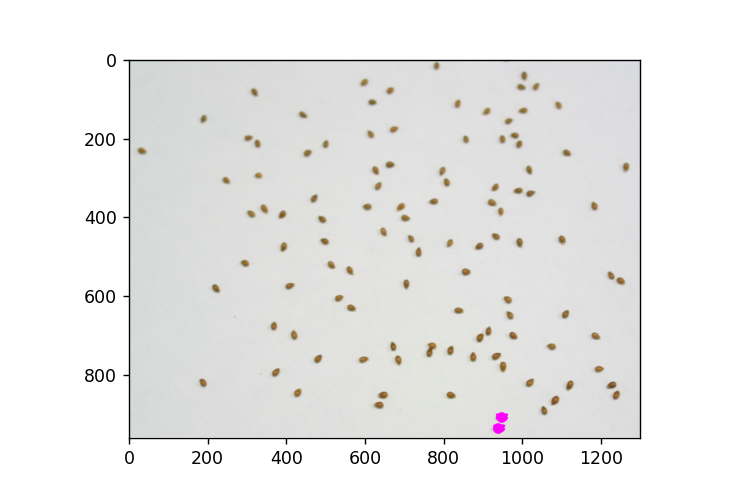

<IPython.core.display.Javascript object>


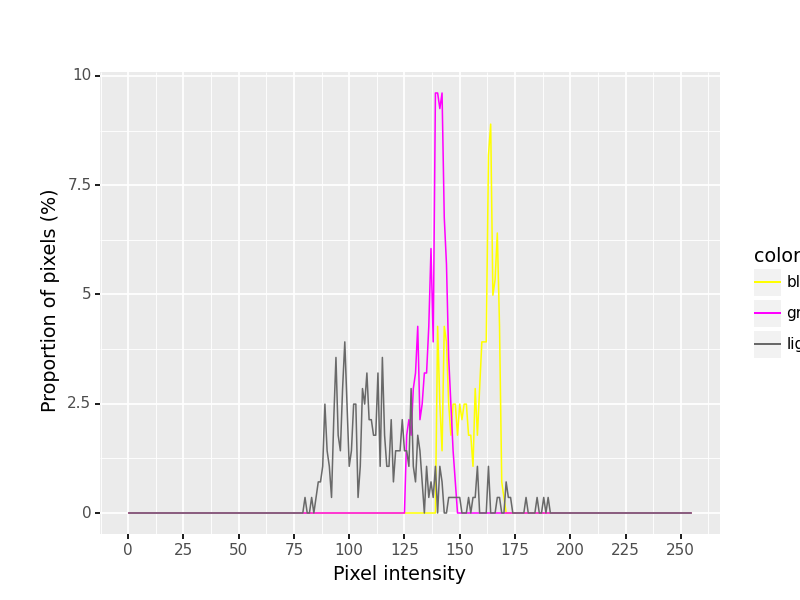

<IPython.core.display.Javascript object>


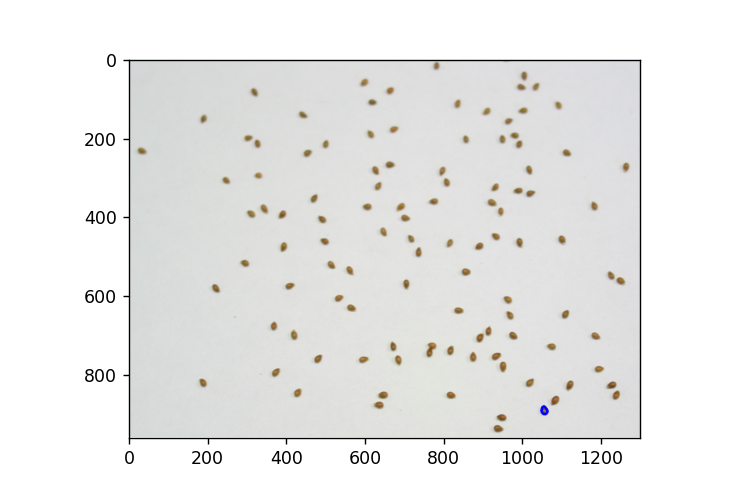

<IPython.core.display.Javascript object>


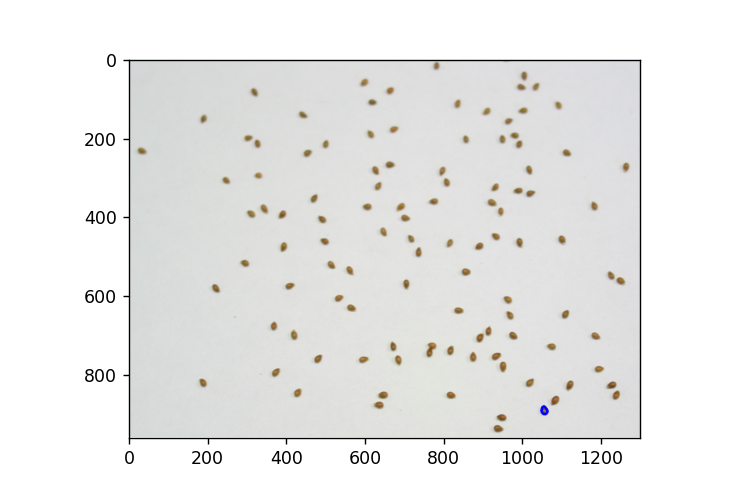

C:\Users\semex_7vulq7b\Documents\progpython\lib\site-packages\plantcv\plantcv\plot_image.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


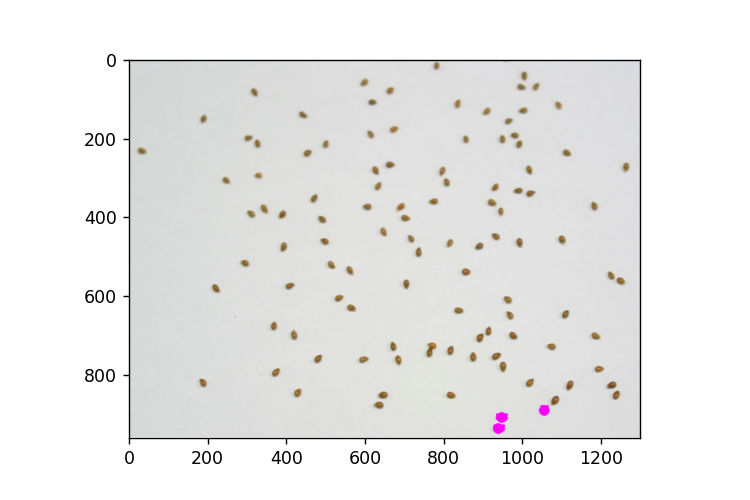

<IPython.core.display.Javascript object>


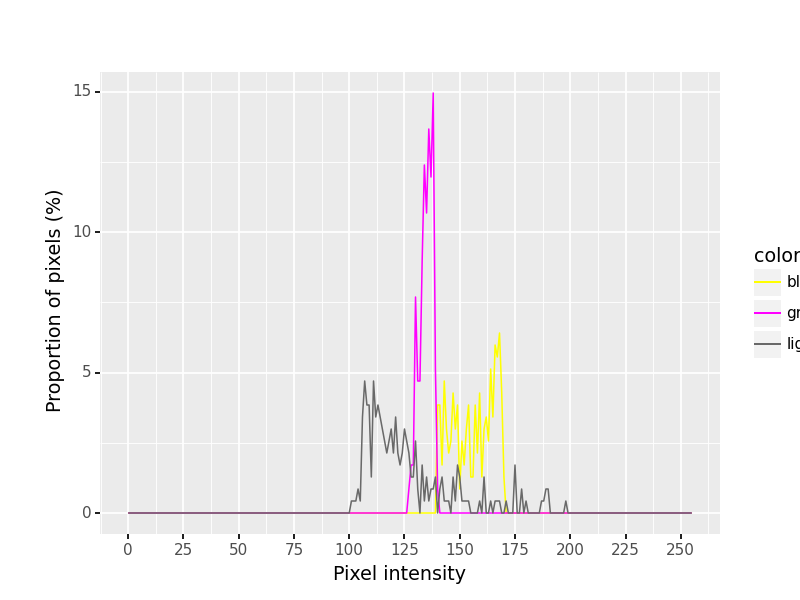

<IPython.core.display.Javascript object>


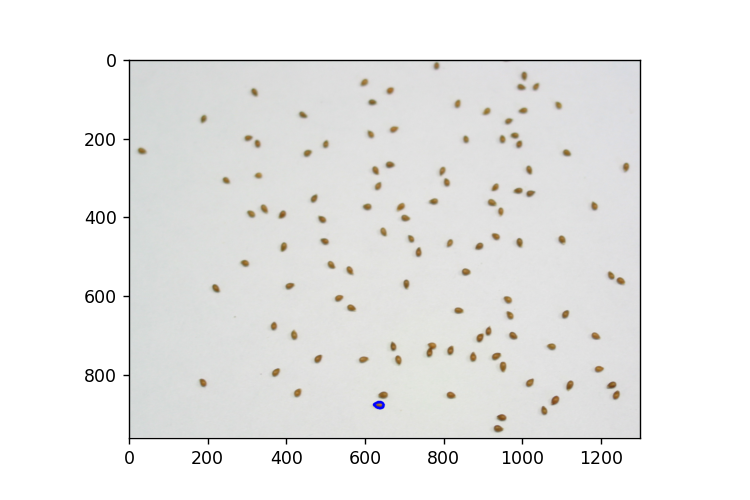

<IPython.core.display.Javascript object>


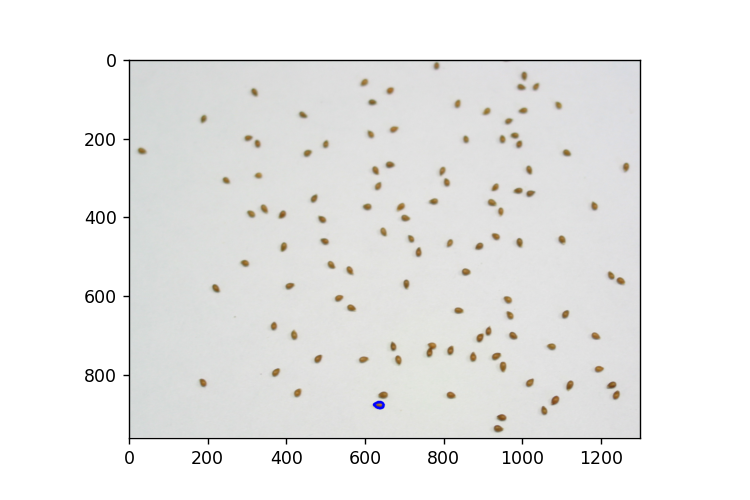

<IPython.core.display.Javascript object>


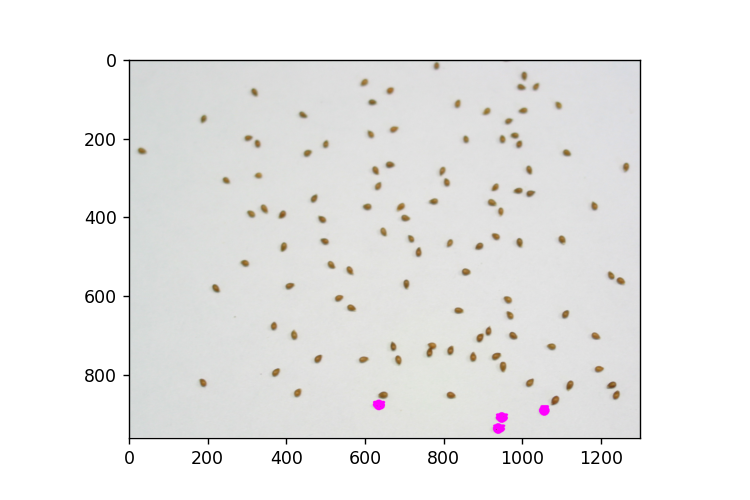

<IPython.core.display.Javascript object>


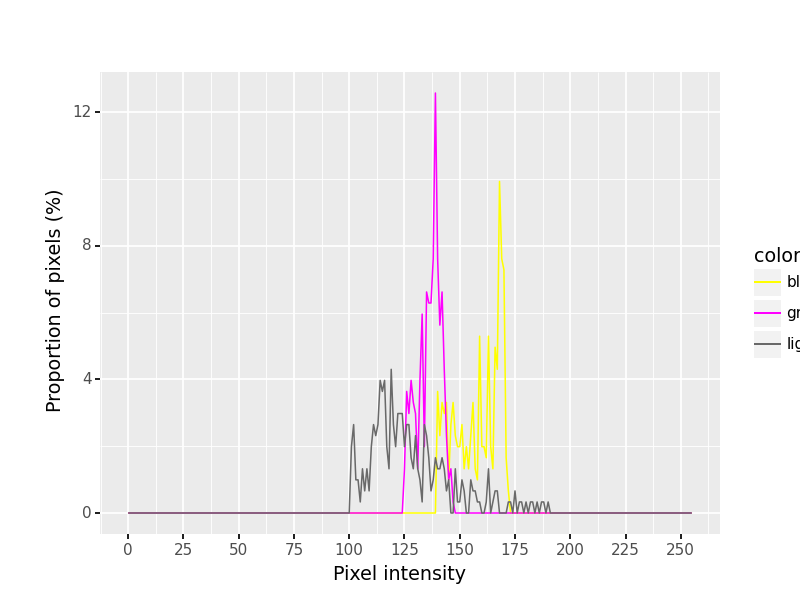

<IPython.core.display.Javascript object>


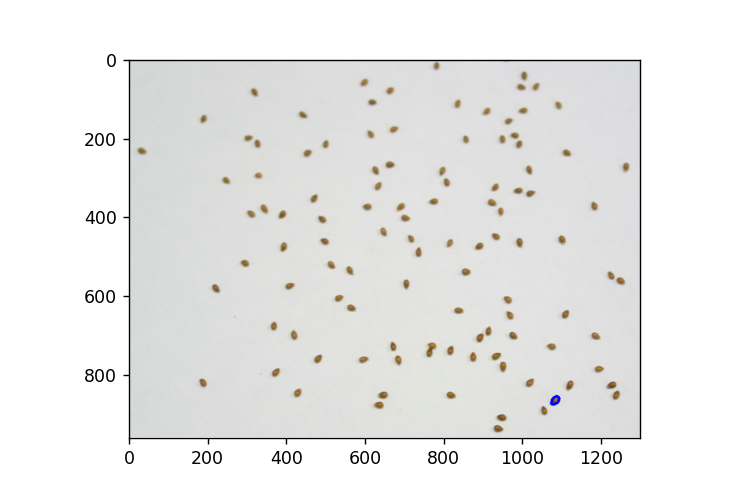

<IPython.core.display.Javascript object>


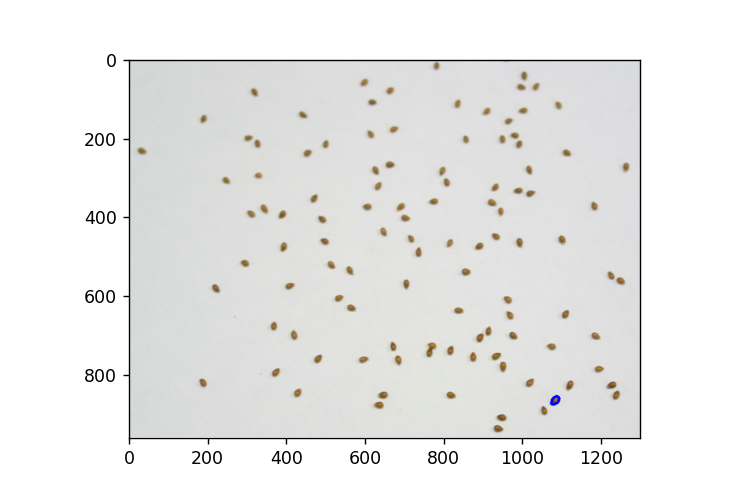

<IPython.core.display.Javascript object>


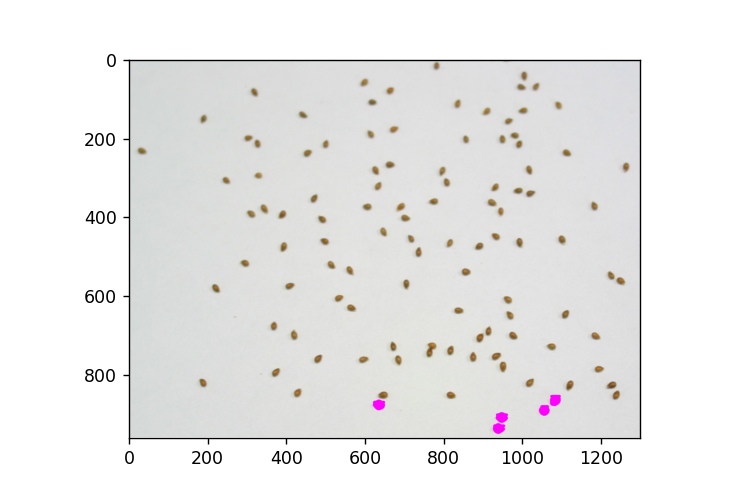

<IPython.core.display.Javascript object>


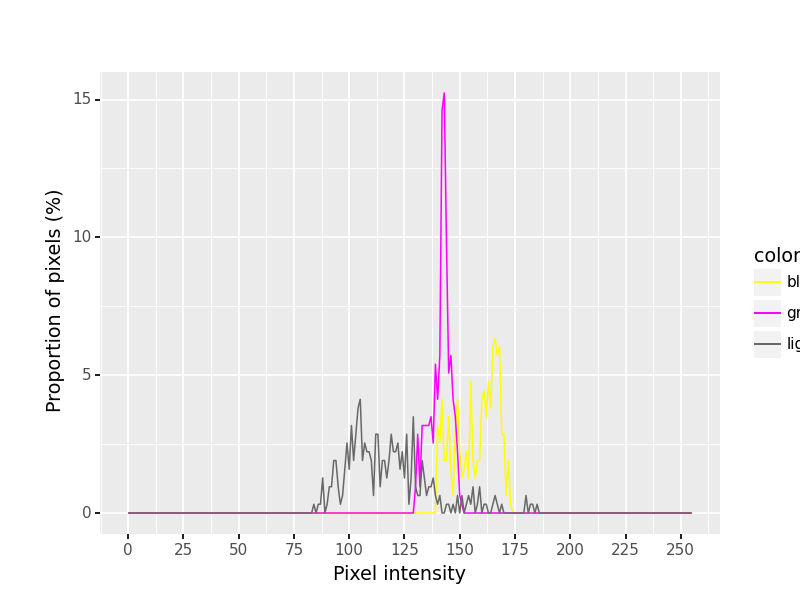

<IPython.core.display.Javascript object>


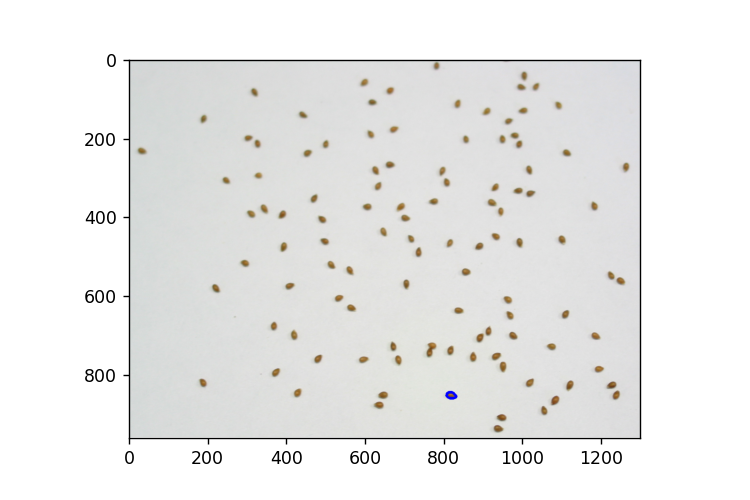

<IPython.core.display.Javascript object>


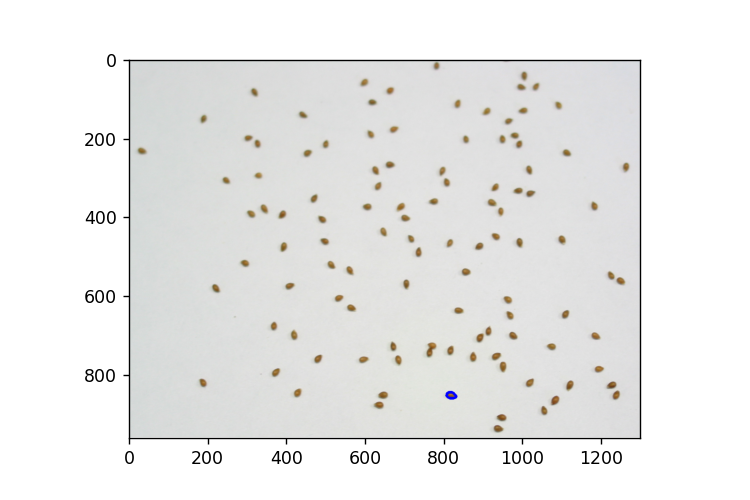

<IPython.core.display.Javascript object>


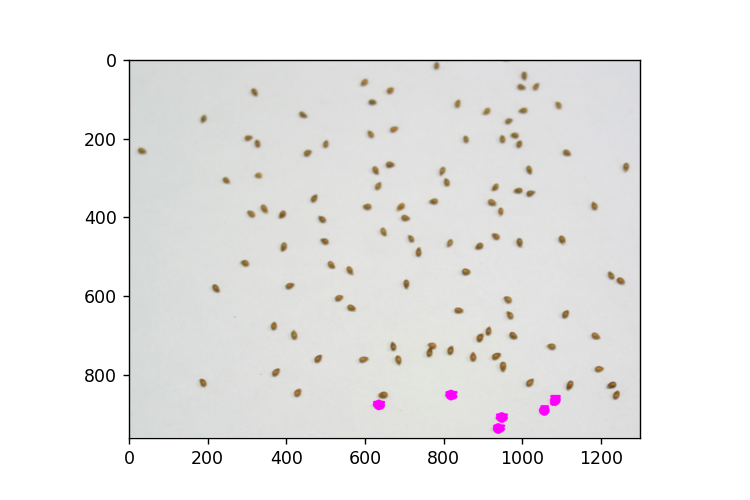

<IPython.core.display.Javascript object>


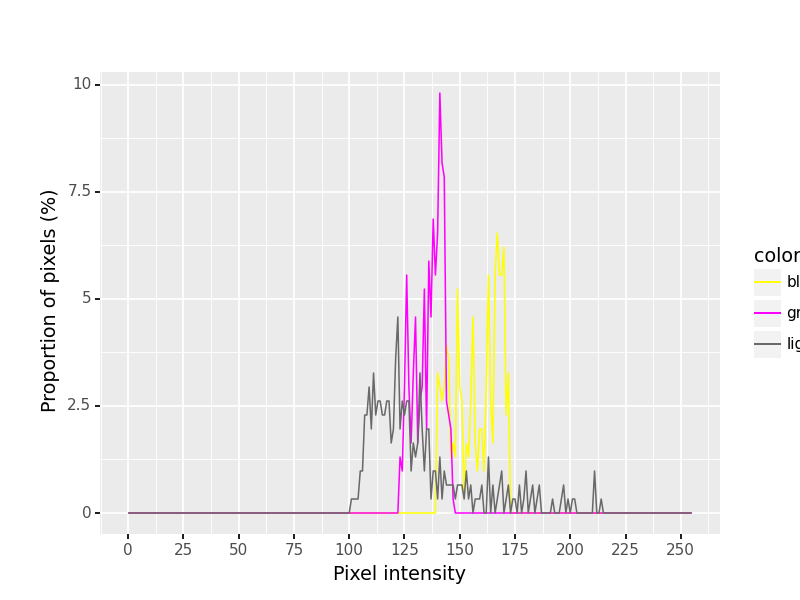

<IPython.core.display.Javascript object>


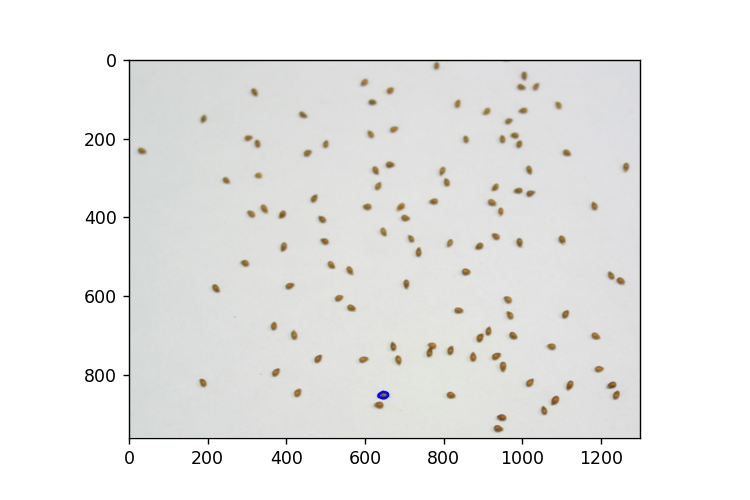

<IPython.core.display.Javascript object>


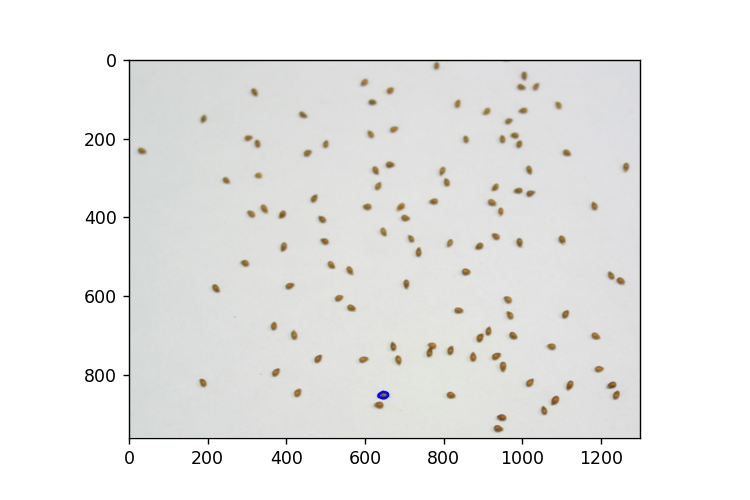

<IPython.core.display.Javascript object>


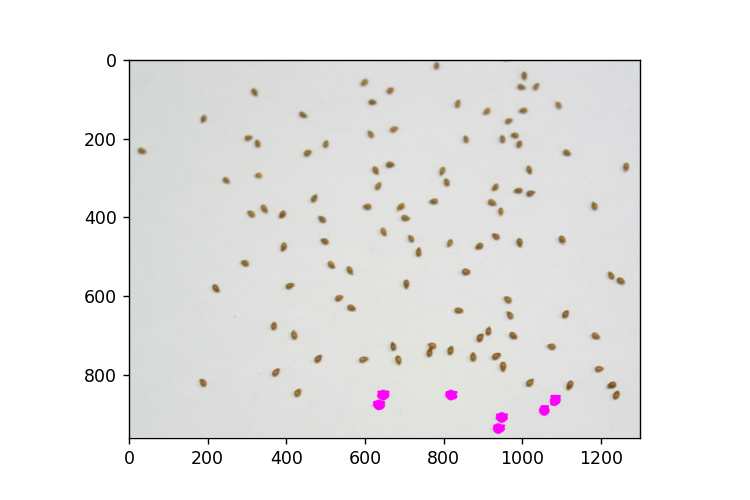

<IPython.core.display.Javascript object>


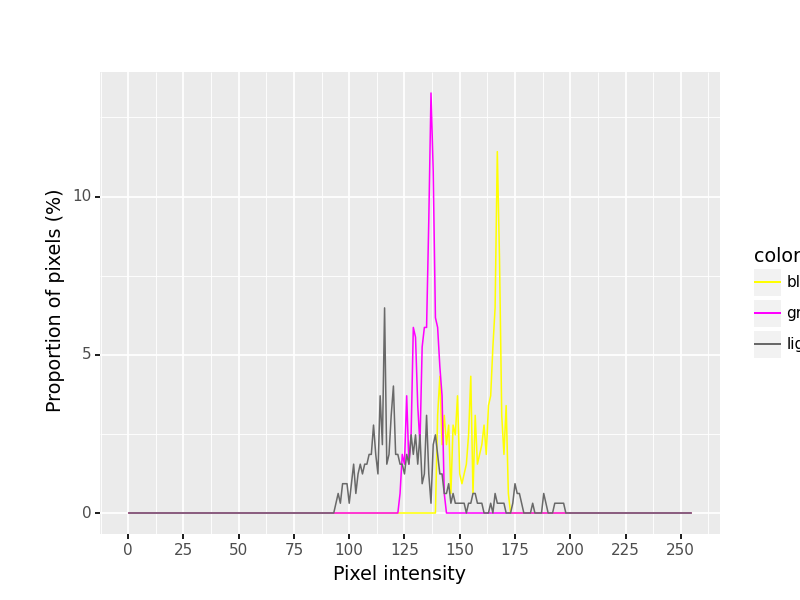

<IPython.core.display.Javascript object>


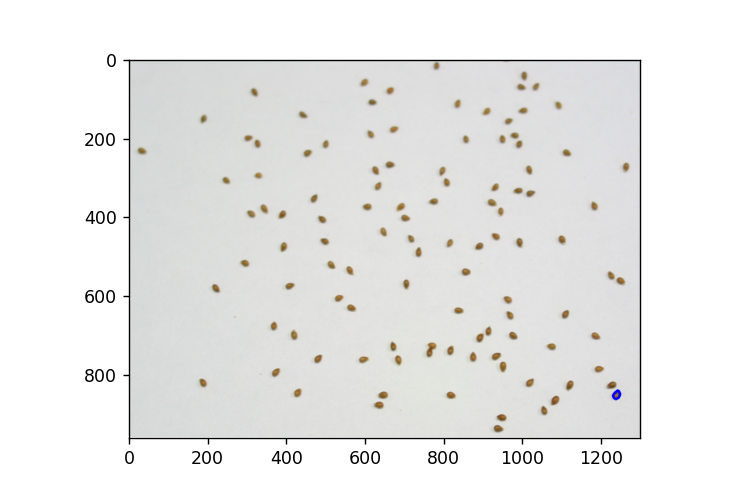

<IPython.core.display.Javascript object>


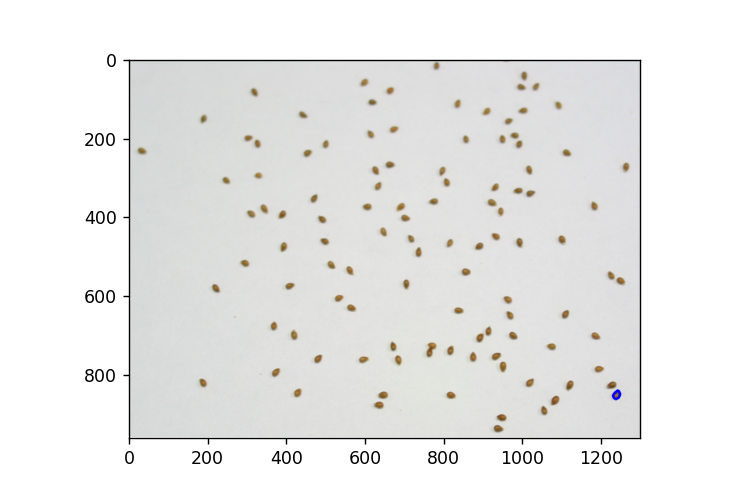

<IPython.core.display.Javascript object>


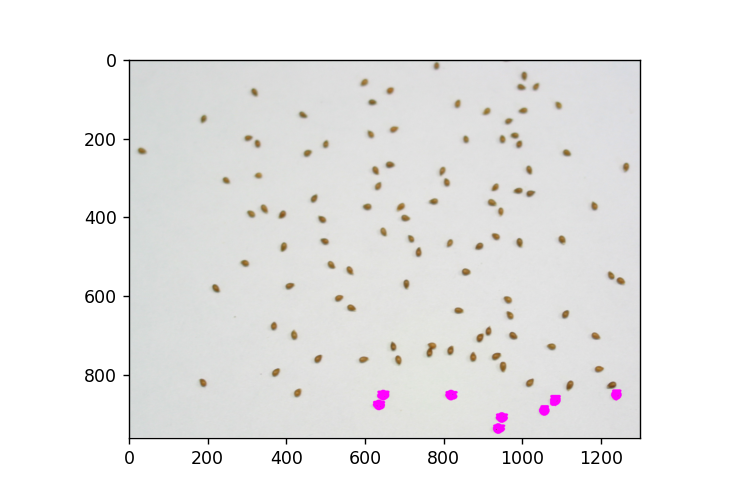

<IPython.core.display.Javascript object>


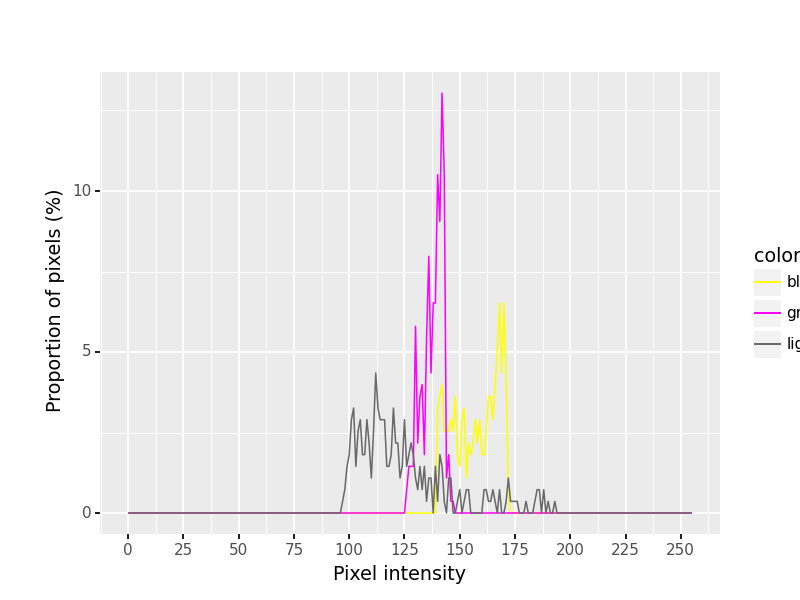

<IPython.core.display.Javascript object>


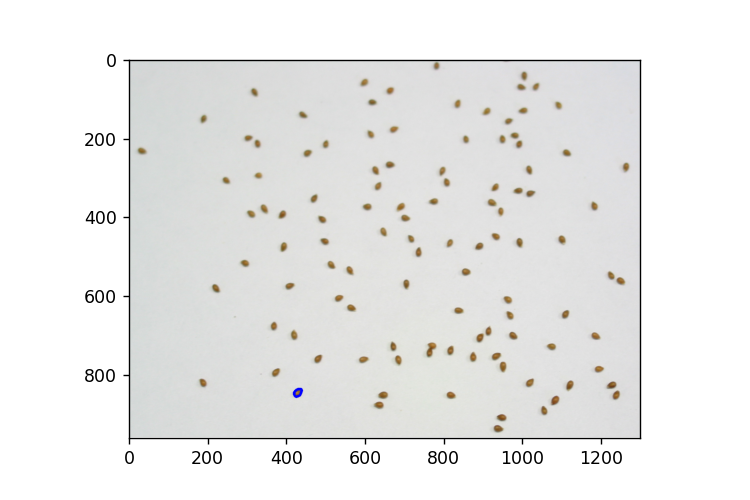

<IPython.core.display.Javascript object>


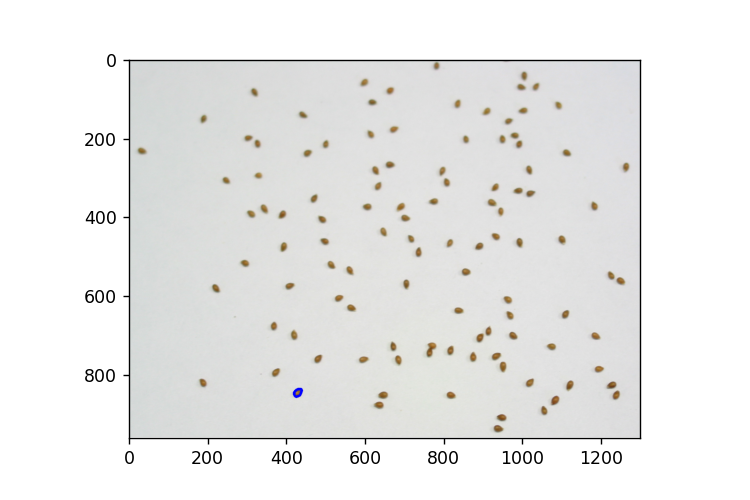

<IPython.core.display.Javascript object>


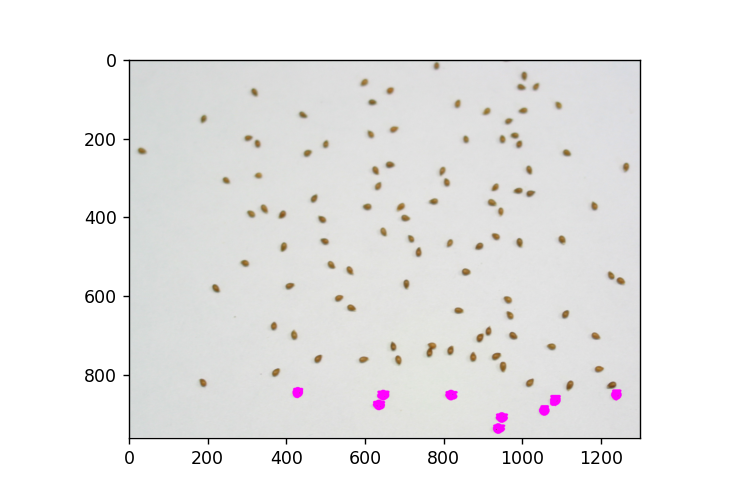

<IPython.core.display.Javascript object>


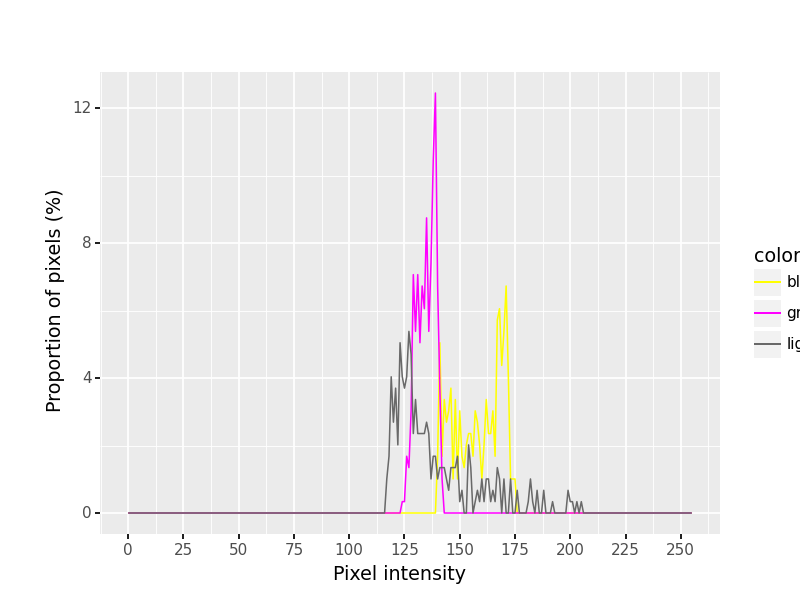

<IPython.core.display.Javascript object>


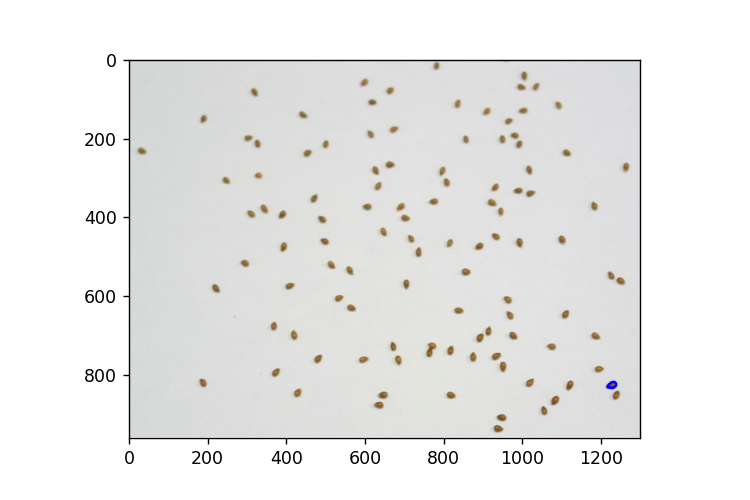

<IPython.core.display.Javascript object>


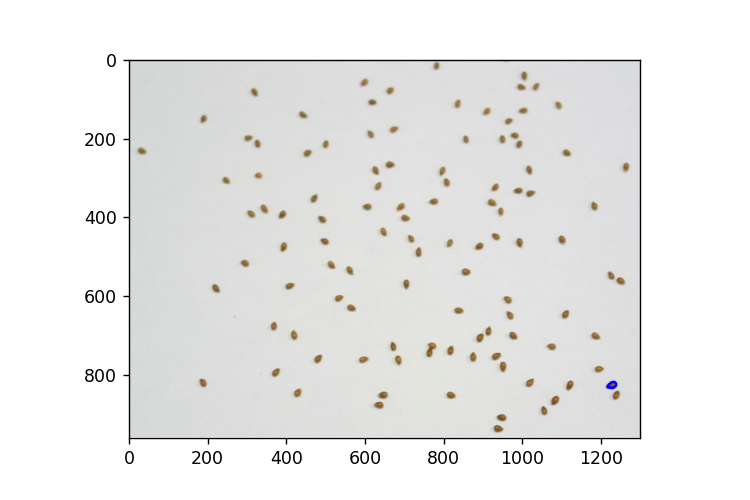

<IPython.core.display.Javascript object>


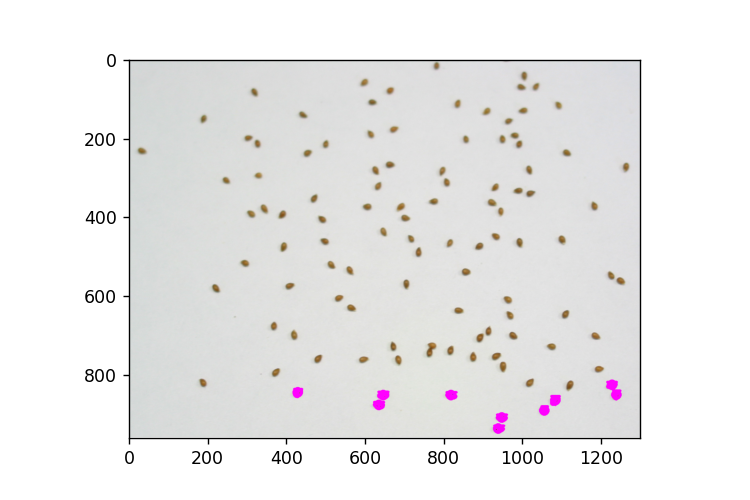

<IPython.core.display.Javascript object>


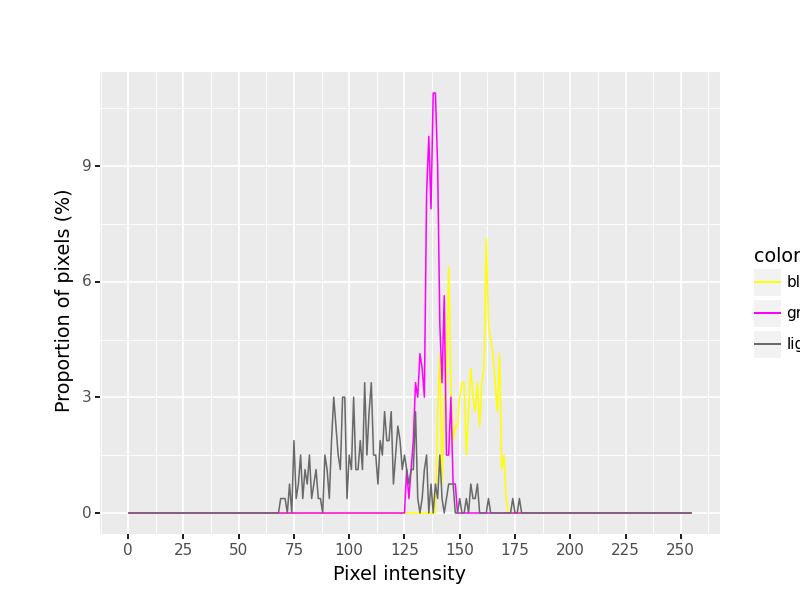

<IPython.core.display.Javascript object>


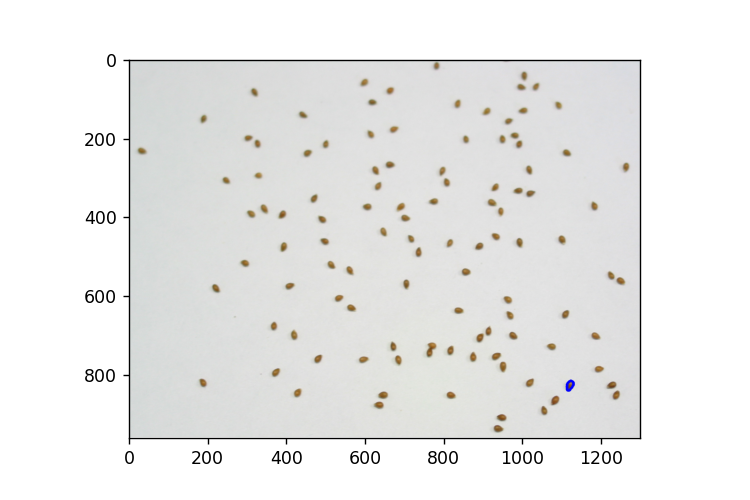

<IPython.core.display.Javascript object>


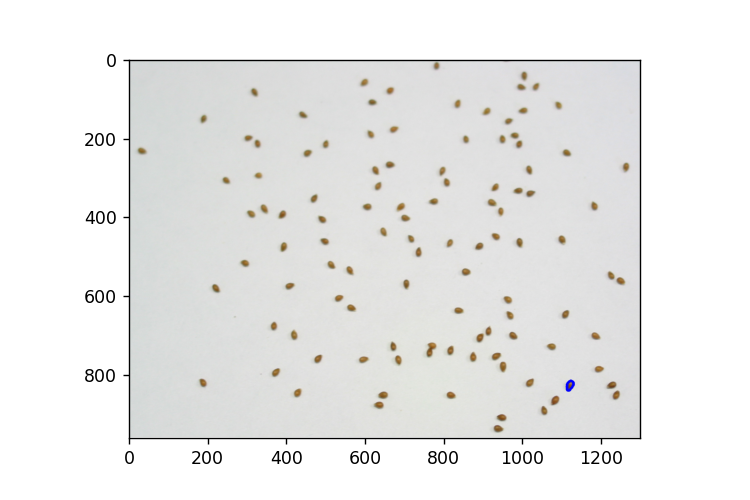

<IPython.core.display.Javascript object>


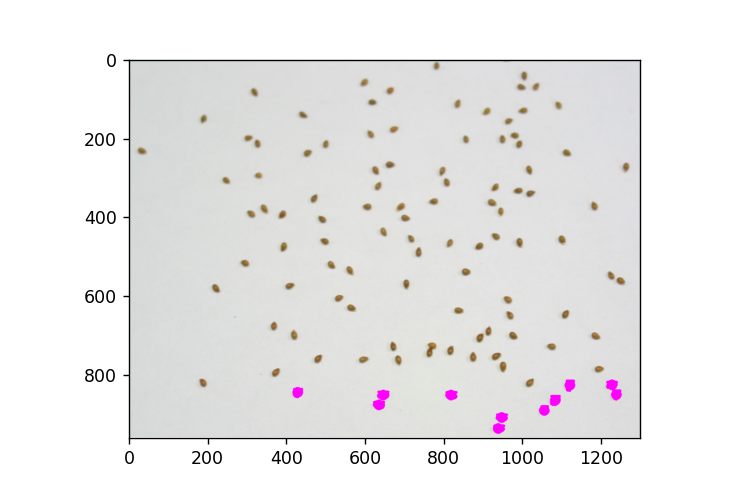

<IPython.core.display.Javascript object>


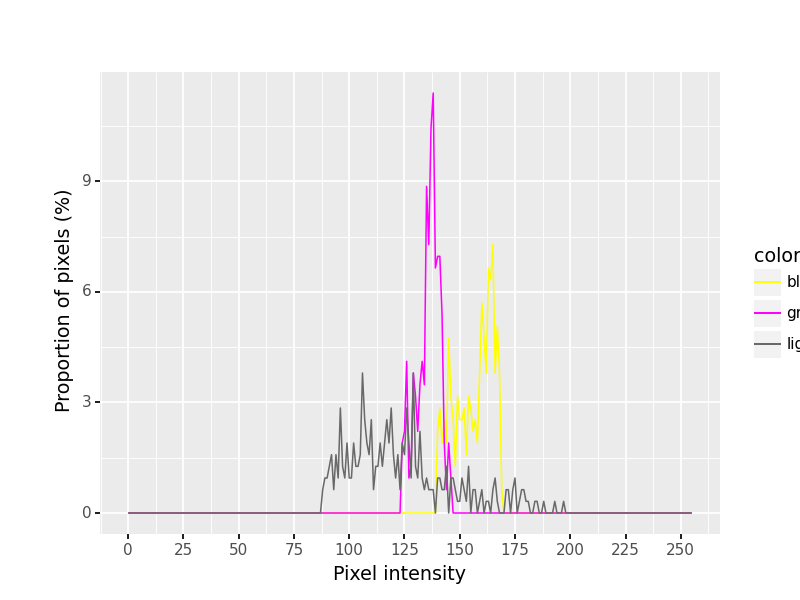

<IPython.core.display.Javascript object>


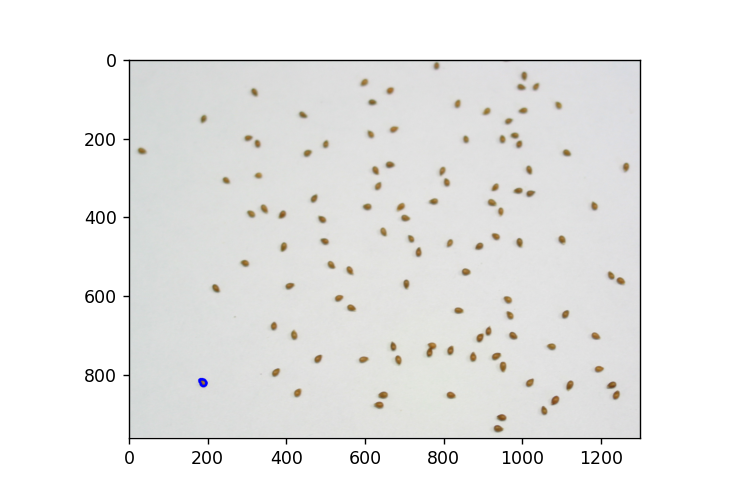

<IPython.core.display.Javascript object>


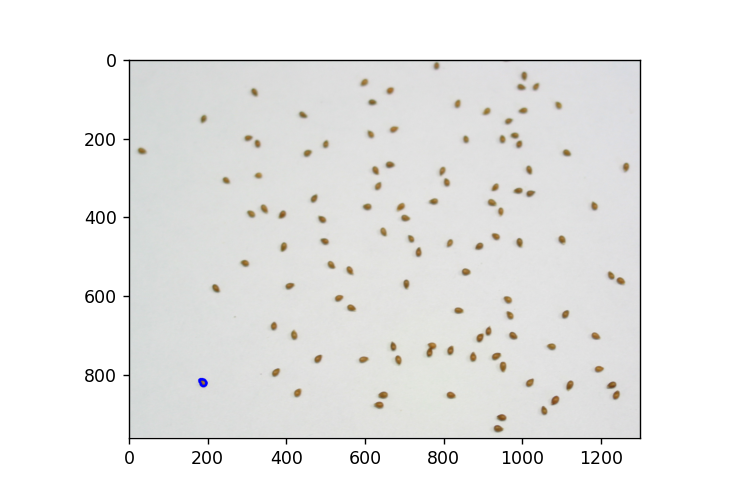

<IPython.core.display.Javascript object>


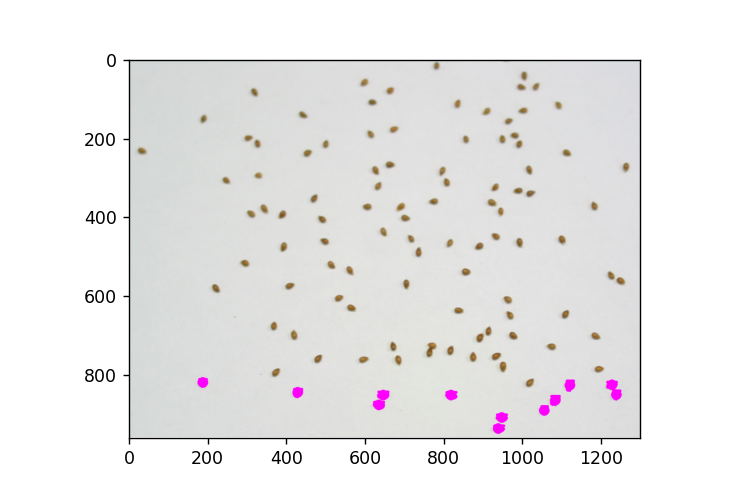

<IPython.core.display.Javascript object>


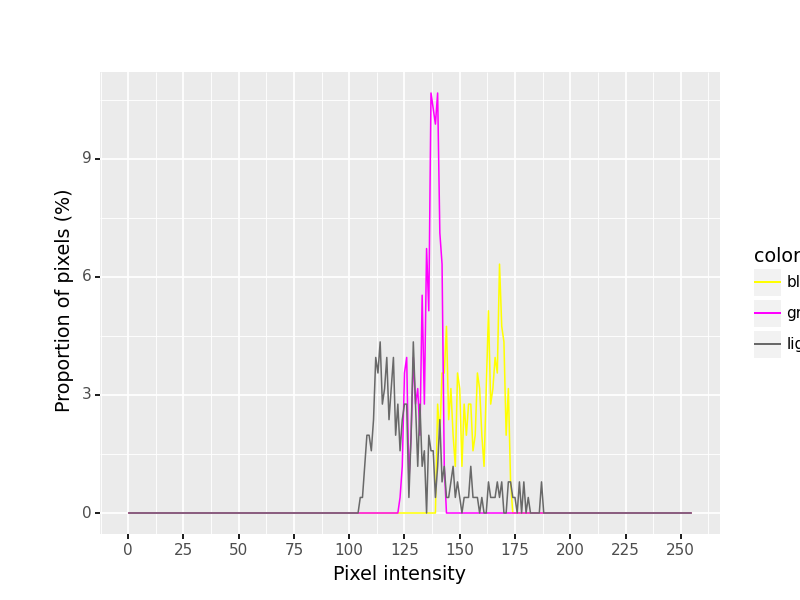

<IPython.core.display.Javascript object>


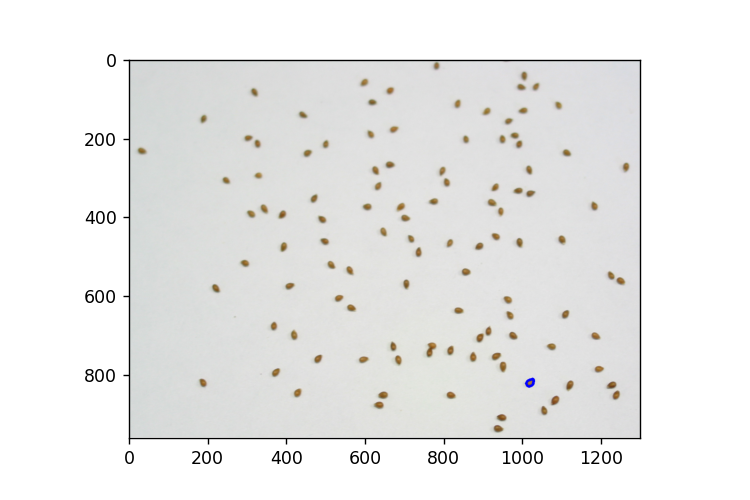

<IPython.core.display.Javascript object>


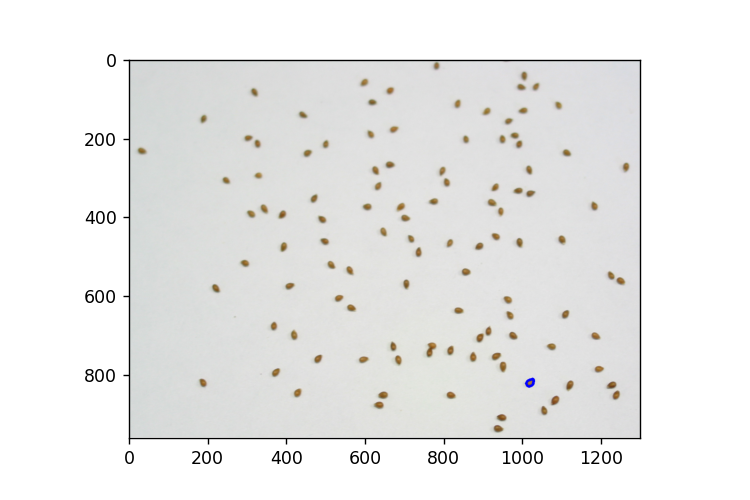

<IPython.core.display.Javascript object>


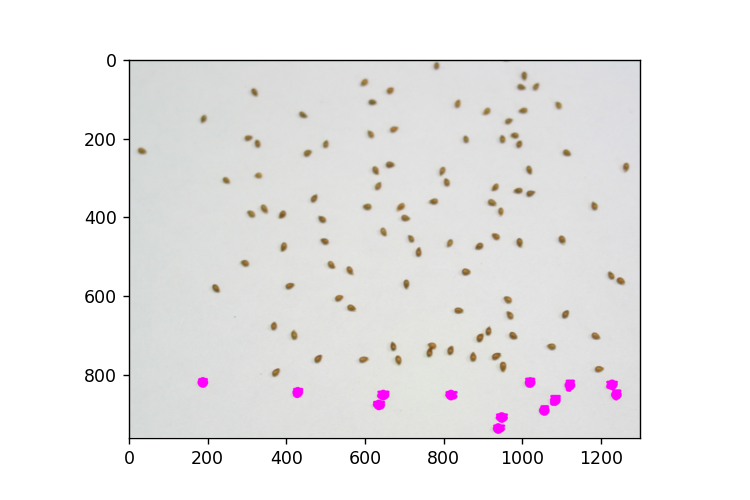

<IPython.core.display.Javascript object>


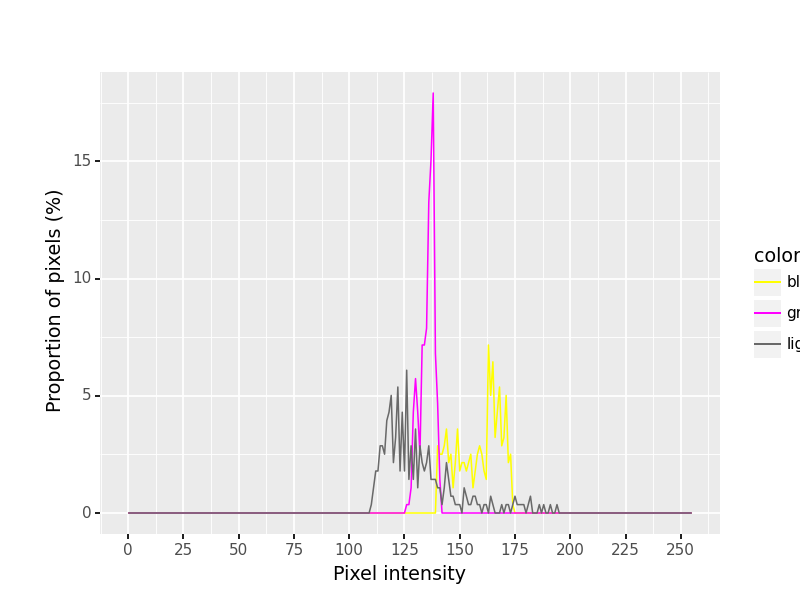

<IPython.core.display.Javascript object>


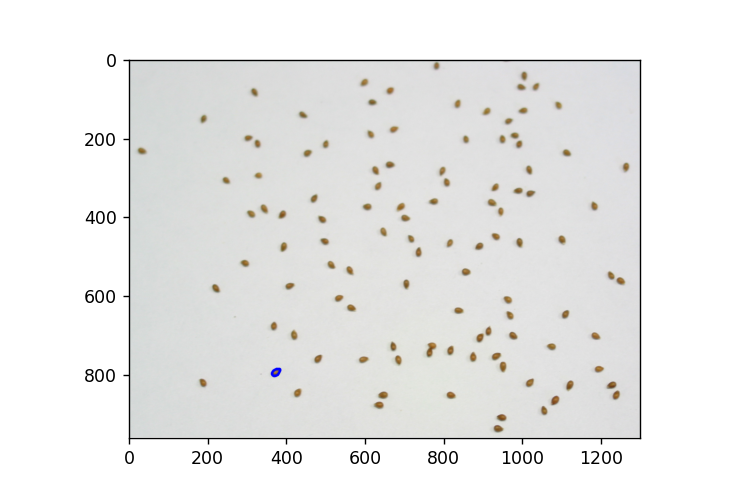

<IPython.core.display.Javascript object>


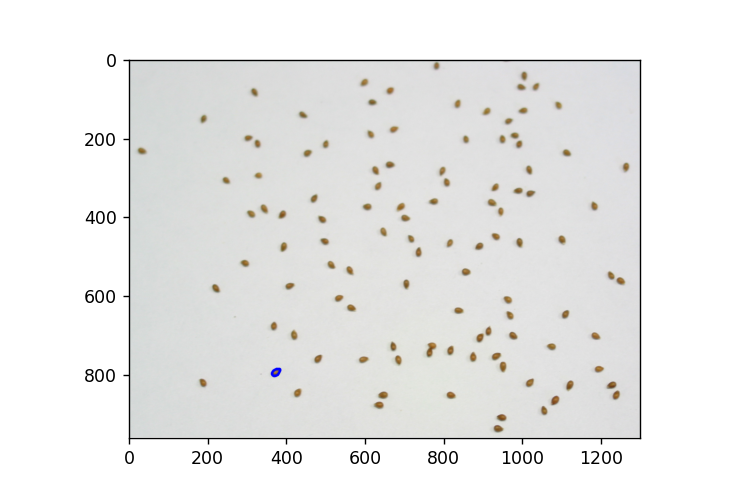

<IPython.core.display.Javascript object>


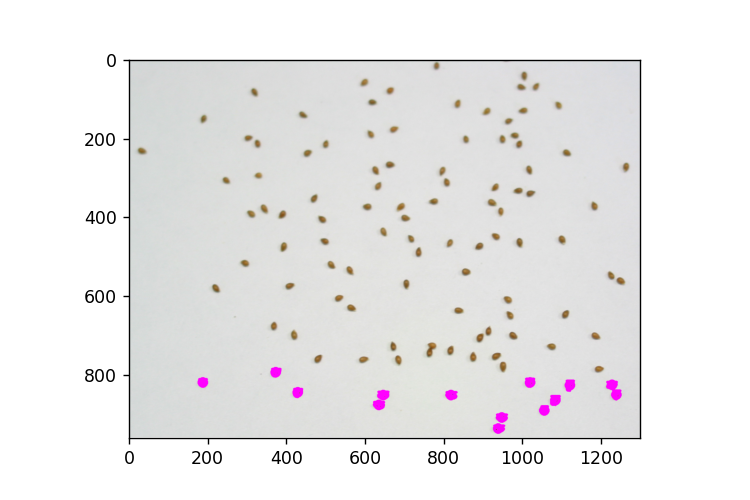

<IPython.core.display.Javascript object>


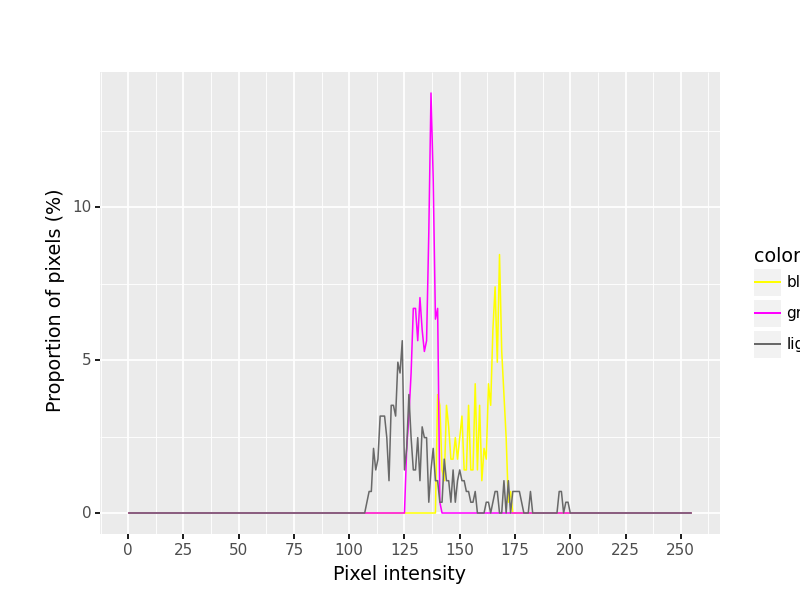

<IPython.core.display.Javascript object>


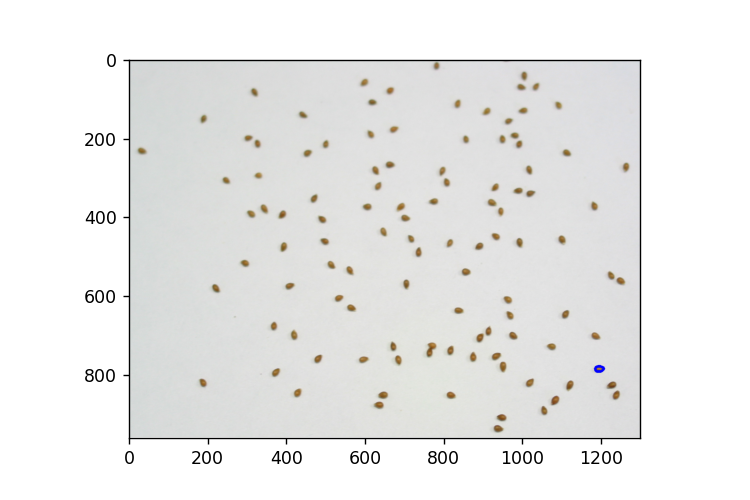

<IPython.core.display.Javascript object>


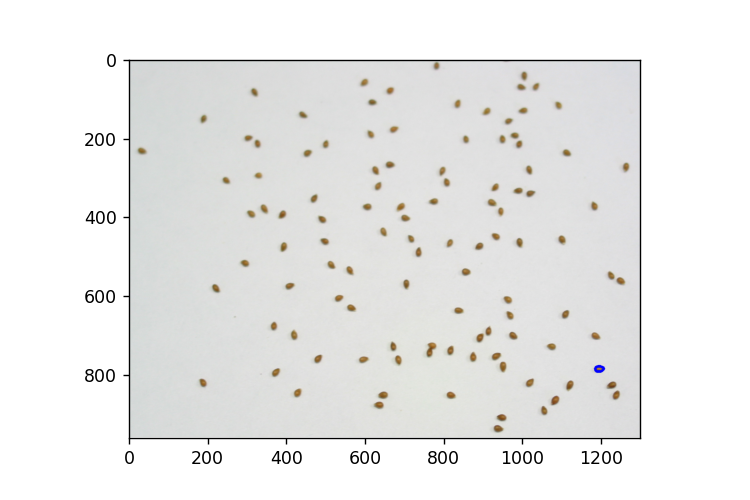

<IPython.core.display.Javascript object>


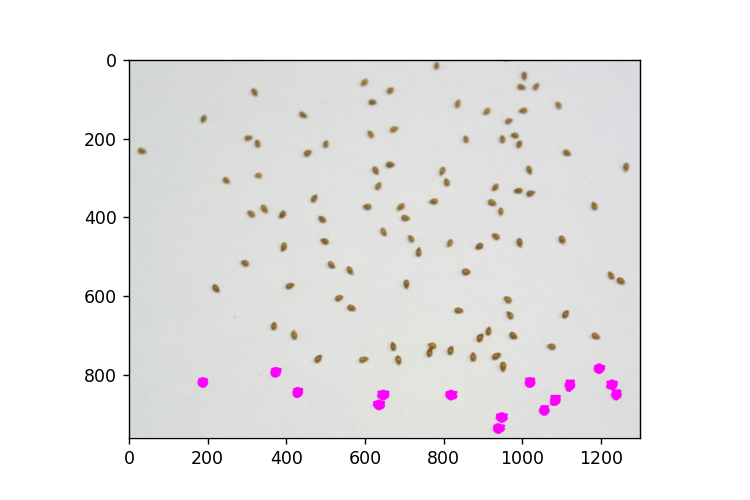

<IPython.core.display.Javascript object>


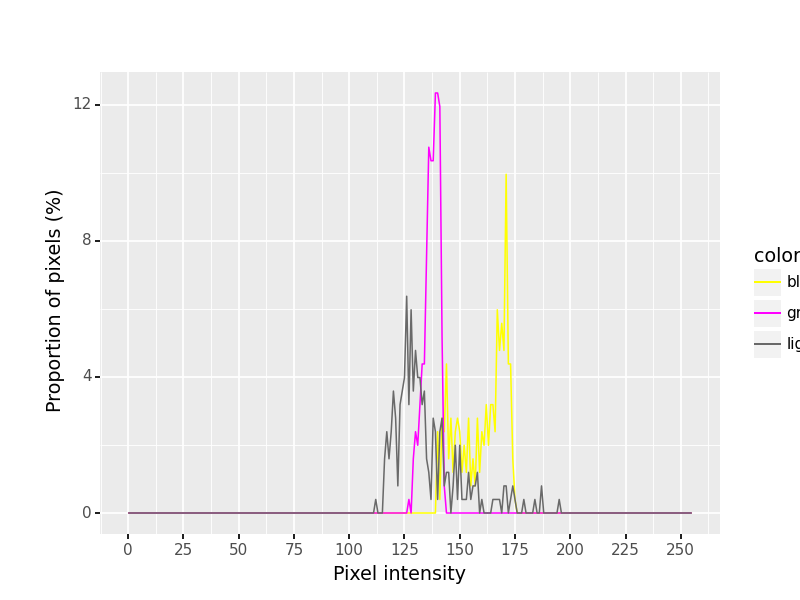

In [23]:
# Se crea una copia de la imagen RGB para el análisis de forma
# Entradas:
#   img = image
shape_img = np.copy(img1)

#se presentan las imagenes y las graficas del color
pcv.params.debug = 'plot'

# Se elimina la opción de presentar gráficas o imágenes
#pcv.params.debug = None

# Hace iteraciones sobre todos los objetos en objects2 y se hace el análisis de forma y color
# for i in range(0, len(objects2)): 
# El bucle anterior consume demasiada memoria, pero idealmente se hace el bucle por cada semilla


# Con un propósito demostrativo, se hace el bucle solo con los primeros 15 objetos
for i in range(0, 15):
    # Se verifica si el objeto tiene una rama en la jerarquía
    if obj_hierarchy[0][i][3] == -1:
        # Crea un objeto y una máscara para un objeto (semilla)
        #
        # Entradas:
        #   img - rgb image
        #   contours - list entry i in objects2
        #   hierarchy - np.array of obj_hierarchy[0][1]
        seed, seed_mask = pcv.object_composition(img=img1, contours=[objects2[i]], hierarchy=np.array([[obj_hierarchy[0][i]]]))
        
        # Analiza la forma de cada semilla
        #
        # Entradas:
        #   img - rgb image
        #   obj - seed
        #   mask - mask created of single seed
        #   label - label for each seed in image
        shape_img = pcv.analyze_object(img=shape_img, obj=seed, mask=seed_mask, label=f"seed{i}")
        
        # Analiza el color de cada semilla
        #
        # Entradas:
        #   img - rgb image
        #   obj - seed
        #   hist_plot_type - 'all', or None for no histogram plot
        #   label - 'default'      
#        color_img = pcv.analyze_color(rgb_img=img1, mask=seed_mask, hist_plot_type=None, label="default")
        color_img = pcv.analyze_color(rgb_img=img1, mask=seed_mask, hist_plot_type='lab', label=f"seed{i}")
  

### Visualización del análisis de forma de las semillas

Durante la secuencia del bucle anterior se desactivó la opción de gráficado y de impresión de imágenes para evitar la reducción significativa de la velocidad de proceso. Ahora, se pueden presentar  las imágenes de los análisis de forma y color para asegurarnos que los resultados están bien.


<IPython.core.display.Javascript object>


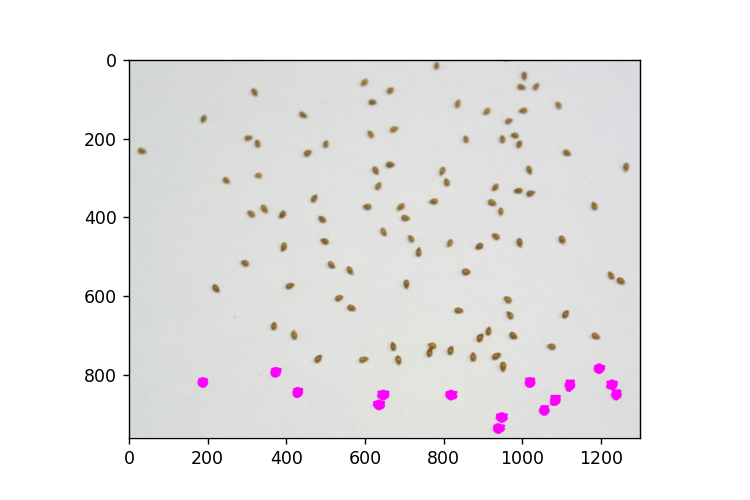

In [24]:
# Entradas:
#   img = image for shape analysis
forma= pcv.plot_image(img=shape_img)

<IPython.core.display.Javascript object>


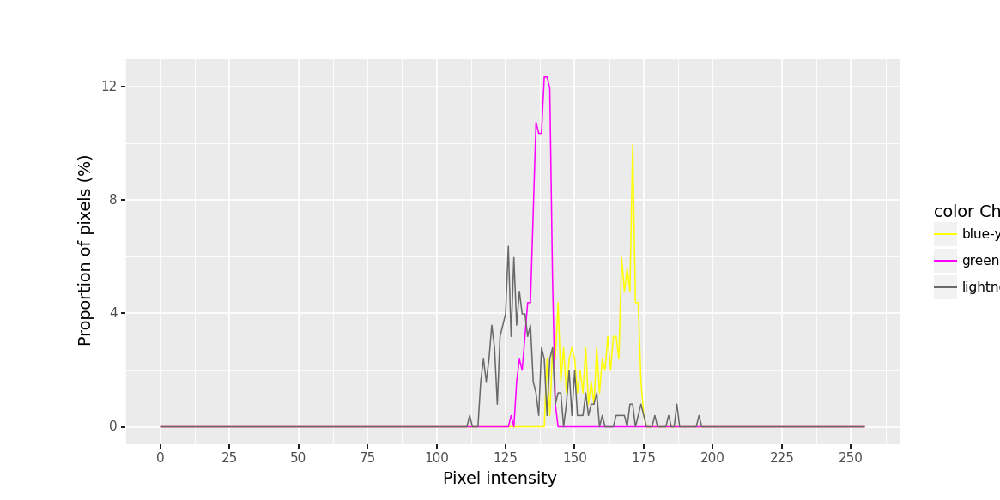

In [25]:
# Entradas:
#   img = image for color analysis
color= pcv.plot_image(img=color_img)

### Enviar los resultados a un archivo

Los resultados se almacenan en una memoria provisional. Para almacenarlos en un archivo se usa la función  save_outputs. Las variables obtenidas con la función analyze_object son: área del objeto, superficie de la envolvente convexa, 'solidity', perímetro, ancho, alto, 'longest path', centro de masa, 'convex_hull_vertices', 'object_in_frame, 'ellipse_center, 'ellipse_major_axis', 'ellipse_minor_axis', 'ellipse_angle', y 'ellipse_eccentricity. Las variables obntenidas con la función analyze_color son las frecuencias de las variables de color. En este ejemplo, los resultados se guardan en un archivo CSV. Sin embargo, cuando el programa se ejecuta en paralelo, es decir cuando se procesan varias imágenes a la vez, entonces los resultados solo se pueden almacenar en el formato json.

In [26]:
# Entradas:
#   filename  = filename for saving results
#   outformat = output file format: "json" (default) hierarchical format or "csv" tabular format

pcv.outputs.save_results(filename=args.result,outformat='csv')